<a href="https://colab.research.google.com/github/CharlesPrado23/BCDataScience1T22N/blob/main/Modelos_Clusterizacao/K_means(Geolocation_2)_ipynb_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
df = pd.read_csv('https://raw.githubusercontent.com/CharlesPrado23/BCDataScience1T22N/main/Modelos_Clusterizacao/california_housing_train.csv')


In [ ]:
df.head()


,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
0,-114.31,34.19,15.0,5612.0,1283.0,1015.0,472.0,1.4936,66900.0
1,-114.47,34.40,19.0,7650.0,1901.0,1129.0,463.0,1.8200,80100.0
2,-114.56,33.69,17.0,720.0,174.0,333.0,117.0,1.6509,85700.0
3,-114.57,33.64,14.0,1501.0,337.0,515.0,226.0,3.1917,73400.0
4,-114.57,33.57,20.0,1454.0,326.0,624.0,262.0,1.9250,65500.0


In [ ]:
df.isna().sum()

longitude             0
latitude              0
housing_median_age    0
total_rooms           0
total_bedrooms        0
population            0
households            0
median_income         0
median_house_value    0
dtype: int64

In [ ]:
df_filt = df.loc[:,['housing_median_age','latitude','longitude']]
df_filt

,housing_median_age,latitude,longitude
0,15.0,34.19,-114.31
1,19.0,34.40,-114.47
2,17.0,33.69,-114.56
3,14.0,33.64,-114.57
4,20.0,33.57,-114.57
...,...,...,...
16995,52.0,40.58,-124.26
16996,36.0,40.69,-124.27
16997,17.0,41.84,-124.30
16998,19.0,41.80,-124.30


In [ ]:
property_clustering = df_filt.drop(['housing_median_age'],1)


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  """Entry point for launching an IPython kernel.


# Avaliando Clusterização usando Elbow 

# In cluster analysis, the elbow method is a heuristic used in determining the number of clusters in a data set. The method consists of plotting the explained variation as a function of the number of clusters, and picking the elbow of the curve as the number of clusters to use

# $ minimize\Bigg(\sum^k_{k=1}W(C_k)\Bigg) $

# where $C_k$ is the  $ k^{th} $ cluster and $W(C_k)$ is the within-cluster variation

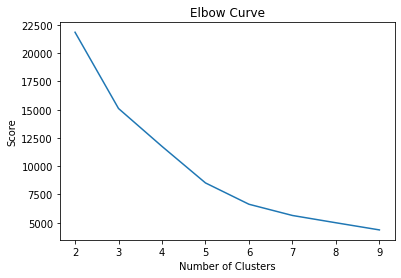

In [ ]:
K_clusters = range(2,10)
kmeans = [KMeans(n_clusters=i) for i in K_clusters]


#kmeans= []
#for i in K_clusters: 
#  kmeans[i] = KMeans(n_clusters=i) 



Y_axis = df_filt[['latitude']]
X_axis = df_filt[['longitude']]
score = [kmeans[i].fit(property_clustering).inertia_ for i in range(len(kmeans))]

#score = [kmeans[i].fit(Y_axis).score(Y_axis) for i in range(len(kmeans))]


#score = [] 
#for i in range(len(kmeans)):
#  score[i]  = kmeans[i].fit(property_clustering).score(property_clustering)

# Visualize
plt.plot(K_clusters, score)
plt.xlabel('Number of Clusters')
plt.ylabel('Score')
plt.title('Elbow Curve')
plt.show()


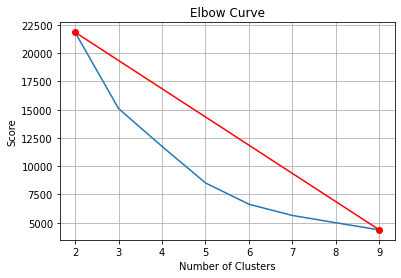

In [ ]:
plt.plot(K_clusters, score)
plt.xlabel('Number of Clusters')
plt.ylabel('Score')
plt.title('Elbow Curve')
plt.plot([K_clusters[0],K_clusters[7]],[score[0],score[7]],'-ro')
plt.grid()
plt.show()


In [ ]:
from sklearn.metrics import silhouette_score
for i in range(2,9):
  kmeans_ = KMeans(n_clusters=i).fit(property_clustering)
  labels_ = kmeans_.labels_
  coef = silhouette_score(property_clustering,labels_)
  
  print("N_cluster: {}, score: {}".format(i,coef))

N_cluster: 2, score: 0.7574203428685329
N_cluster: 3, score: 0.6470167963617863
N_cluster: 4, score: 0.5998665873573714
N_cluster: 5, score: 0.5823550703422058
N_cluster: 6, score: 0.5681899997637054
N_cluster: 7, score: 0.5695103013490443
N_cluster: 8, score: 0.5238829105923207


In [ ]:
kmeans = KMeans(n_clusters = 2,random_state=0).fit(property_clustering)
kmeans.labels_
df_filt.insert(0, 'Cluster_Labels', kmeans.labels_)
df_filt.head()

,Cluster_Labels,housing_median_age,latitude,longitude
0,0,15.0,34.19,-114.31
1,0,19.0,34.40,-114.47
2,0,17.0,33.69,-114.56
3,0,14.0,33.64,-114.57
4,0,20.0,33.57,-114.57


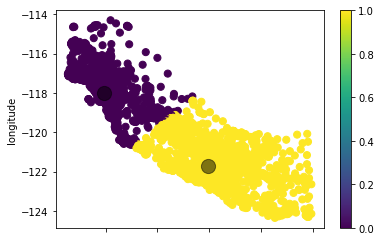

In [ ]:
centers = kmeans.cluster_centers_
labels  = kmeans.labels_
df_filt.plot.scatter(x = 'latitude', y = 'longitude', c=labels, s=50, cmap='viridis')
plt.scatter(centers[:, 0], centers[:, 1], c='black', s=200, alpha=0.5)

In [ ]:

df6 = df_filt.groupby('Cluster_Labels')['housing_median_age'].mean()

In [ ]:
df6.head()

Cluster_Labels
0    28.342930
1    28.930063
Name: housing_median_age, dtype: float64

In [ ]:
!pip install folium==0.5.0 

     |████████████████████████████████| 79 kB 3.3 MB/s 
  Created wheel for folium: filename=folium-0.5.0-py3-none-any.whl size=76133 sha256=cd3f9a9ab76c7e25527938910a848ee0f5f9830c7a4a2c4371b2d34ecfb30a3f
  Stored in directory: /root/.cache/pip/wheels/b2/2f/2c/109e446b990d663ea5ce9b078b5e7c1a9c45cca91f377080f8
Successfully built folium
  Attempting uninstall: folium
    Found existing installation: folium 0.8.3
    Uninstalling folium-0.8.3:
      Successfully uninstalled folium-0.8.3
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
datascience 0.10.6 requires folium==0.2.1, but you have folium 0.5.0 which is incompatible.


In [ ]:
#!pip install folium
import folium # plotting library

In [ ]:
centers[0][0]

33.936714647744544

In [ ]:
map = folium.Map(location=[centers[0][0], centers[0][1]], zoom_start=13)

for lat, lng , label in zip(df_filt.latitude, df_filt.longitude,df_filt.Cluster_Labels):
    folium.CircleMarker(
        [lat, lng],
        radius=2,
        color='blue' if label==0 else 'green',
        popup=str(label),
        fill = True,
        #fill_color = 'blue',
        fill_opacity= 0.6
    ).add_to(map)




In [ ]:
map